<a href="https://colab.research.google.com/github/tuliofalmeida/pyjama/blob/main/PyJama_Lokomat.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#PyJama - Python for Joint Angle Measurement Acquisition Library
##Lokomat example

Joint angle measure using PyJama

This notebook uses an open source project [tuliofalmeida/pyjama](https://pypi.org/project/pyjamalib/) to estimate knee angle using IMU data and video.

In this example we use the joint angle measurement device that we developed coupled to [Lokomat](https://www.hocoma.com/solutions/lokomat/), in order to validate the developed device and the PyJama. In order to compare the findings, we film and extracted the angle using the [Kinovea](https://www.kinovea.org/) software.

IMU aquisition parameters:
*   Frequency: 75 Hz
*   Aquisition duration: 120s

Lokomat parameters: 
*   Min knee angle = 0°
*   Max knee angle = 60°
*   Velocity = 1 km/h

Video details: 
*   Duration: 00:02:58
*   FPS: 30

For other examples and details about the library, visit [Pyjama GitHub](https://github.com/tuliofalmeida/pyjama).

In [120]:
#@title Video of the lokomat with the sensors
from moviepy.editor import *

path="/content/drive/MyDrive/Dissertação/Dados/Videos Lokomat/Kinovea/video.mp4" 

clip=VideoFileClip(path)
clip.ipython_display(width=640, height=480)

100%|██████████| 398/398 [00:18<00:00, 21.74it/s]


## Install PyJama

In [ ]:
!pip install pyjamalib==0.5.43

## Import the libraries

In [ ]:
import pyjamalib as pjl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
%load_ext google.colab.data_table

The google.colab.data_table extension is already loaded. To reload it, use:
  %reload_ext google.colab.data_table


## Load the data

In [ ]:
#Lokomat data
file = 'Lokomat_Trial_5'
path = '/content/drive/MyDrive/Dissertação/Dados/dado'+file+'.txt'
pathTempo = '/content/drive/MyDrive/Dissertação/Dados/dadoTempo'+file+'.txt'
data,dt = pjl.DataHandler.import_raw_data(path,pathTempo)

#Lokomat calibration data
file_calib = 'Calib_Lokomat'
path_calib = '/content/drive/MyDrive/Dissertação/Dados/dado'+file_calib+'.txt'
pathTempo_calib = '/content/drive/MyDrive/Dissertação/Dados/dadoTempo'+file_calib+'.txt'
data_calib,dt_calib = pjl.DataHandler.import_raw_data(path_calib,pathTempo_calib)

#Video data from Kinovea
kinovea = pd.read_csv('/content/drive/MyDrive/Dissertação/Dados/Videos Lokomat/Kinovea/knee_angle_kinovea.csv',delimiter=';')

In [ ]:
#Separating the data from the sensor positioned on the 'thigh'
thigh_data = pjl.DataHandler.split_raw_data(data[6])
thigh_calibration = pjl.DataHandler.split_raw_data(data_calib[6])

#Separating the data from the sensor positioned on the 'shank'
shank_data = pjl.DataHandler.split_raw_data(data[5])
shank_calibration = pjl.DataHandler.split_raw_data(data_calib[5])

## Performing data processing. The 'toDataFrame' function performs the filtering of the data and saves it in a pandas data frame.

In [ ]:
#Processing 'thigh' sensor data
thigh_df = pjl.DataProcessing.toDataframe(thigh_data[500:],thigh_calibration,beta=1,alpha=0.01,beta_mag2=.6)
#Processing 'shank' sensor data
shank_df = pjl.DataProcessing.toDataframe(shank_data[500:],shank_calibration,beta=1,alpha=0.01,beta_mag2=.6)

In [ ]:
#Processing the video data
data_kinovea = np.asarray([float(kinovea['Knee Angle'][i].replace(',', '.')) for i in range(len(kinovea['Knee Angle']))])
time_kinovea = np.arange(0, len(data_kinovea)/30, 1/30)

## The 'joint_angle' function merges the data, extracts statistical metrics and saves them in a pandas data frame.

In [ ]:
knee_angle,knee_metrics = pjl.DataProcessing.joint_measures(thigh_df,shank_df,patternRoll=True,init=1500)

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)


In [ ]:
#@title Knee joint data from IMU { vertical-output: true }
knee_angle

,Time,Flex/Ext,Adu/Abd,Int/Ext_Rot,Flex/Ext_CF,Adu/Abd_CF,Int/Ext_Rot_CF,Flex/Ext_CF_GD,Adu/Abd_CF_GD,Int/Ext_Rot_CF_GD,Flex/Ext_CF_GN,Adu/Abd_CF_GN,Int/Ext_Rot_CF_GN,Flex/Ext_Kalman_GD,Adu/Abd_Kalman_GD,Int/Ext_Rot_Kalman_GD,Flex/Ext_Kalman_GN,Adu/Abd_Kalman_GN,Int/Ext_Rot_Kalman_GN,Flex/Ext_Madgwick,Adu/Abd_Madgwick,Int/Ext_Rot_Madgwick
1500,20.000000,117.887713,8.042020,307.450934,34.250739,11.148299,246.770583,48.136801,2.997053,6.332818,47.438343,3.460526,5.813076,62.349711,13.066420,15.889406,61.378274,7.850794,10.466621,57.267847,3.822899,16.355787
1501,20.013333,119.262880,7.803705,309.707367,34.728656,10.916865,248.211322,49.088090,3.008177,6.228694,48.356668,3.408085,5.753752,62.962918,12.455998,14.282371,61.903510,7.753171,10.028017,56.341849,3.597678,16.293028
1502,20.026667,117.956036,7.695325,310.210223,35.116698,10.691576,249.605117,49.984406,3.015074,6.134857,49.232730,3.360101,5.694657,63.401775,12.230003,13.828876,62.381075,7.659687,9.620769,55.332054,4.108286,16.579219
1503,20.040000,119.278469,7.565923,311.299104,35.550810,10.471088,250.983652,50.830797,2.993309,6.073726,50.042871,3.315651,5.633092,64.590248,11.673332,10.245693,62.784804,7.581531,9.193412,54.638865,4.783415,16.523539
1504,20.053333,118.011182,7.397742,313.064155,35.899175,10.253219,252.381501,51.611739,2.960513,6.012139,50.808759,3.272573,5.571932,64.444444,11.649117,11.723457,63.145107,7.506525,8.784194,53.568399,4.472698,16.447021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8495,113.266667,127.911124,9.302387,292.888541,33.692751,11.883929,230.841598,42.459201,1.389151,6.542220,41.708406,1.895487,6.015511,53.451285,9.114130,21.566736,53.022656,4.957778,17.251955,62.423175,3.603743,16.523515
8496,113.280000,117.082631,8.711769,300.538028,34.092601,11.661229,232.620481,43.614415,1.355431,6.467936,42.883144,1.845427,5.978204,55.332626,8.479094,17.655474,54.093943,5.049866,16.437743,62.146210,3.615264,16.430555
8497,113.293333,127.912479,8.921561,294.347073,35.013440,11.460172,234.000858,44.770899,1.315346,6.436864,44.016798,1.795956,5.939965,55.243242,9.023977,20.652395,55.091084,5.156306,15.720008,61.581362,3.528296,16.341206
8498,113.306667,117.166976,8.381224,302.340873,35.350424,11.242155,235.711874,45.864407,1.277504,6.396265,45.107392,1.748784,5.900301,56.859691,8.605324,17.349207,56.009355,5.259030,15.077436,60.943902,3.504336,16.257038


In [ ]:
knee_rom = pjl.DataProcessing.joint_rom(knee_angle)

In [ ]:
#@title Knee Range of Motion from IMU
knee_rom

,Angles
Flex/Ext,130.116319
Adu/Abd,28.599838
Int/Ext_Rot,374.739861
Flex/Ext_CF,47.948576
Adu/Abd_CF,16.456611
Int/Ext_Rot_CF,312.414472
Flex/Ext_CF_GD,62.921719
Adu/Abd_CF_GD,6.121504
Int/Ext_Rot_CF_GD,8.577378
Flex/Ext_CF_GN,62.072629


In [ ]:
#@title Knee metrics from IMU
knee_metrics

,Movement,Rom,Mean,Std,CI,Var,Min,Max,Min Est,Max Est
0,Flex/Ext,130.116319,35.867609,21.162239,41.477988,447.840340,0.0,130.116319,99.446670,117.518130
1,Flex/Ext_CF,47.948576,38.442215,5.942984,11.648249,35.319059,0.0,47.948576,10.108463,45.230272
2,Flex/Ext_CF_GD,62.921719,53.322237,2.534618,4.967851,6.424288,0.0,62.921719,5.227079,58.415574
3,Flex/Ext_CF_GN,62.072629,53.143335,2.653324,5.200515,7.040129,0.0,62.072629,4.740410,57.727221
4,Flex/Ext_Kalman_GD,70.907296,58.808791,2.899372,5.682770,8.406360,0.0,70.907296,7.358088,63.600011
5,Flex/Ext_Kalman_GN,69.144001,56.806202,2.809367,5.506359,7.892542,0.0,69.144001,6.116024,61.713590
6,Flex/Ext_Madgwick,65.925118,58.281918,2.751705,5.393342,7.571882,0.0,65.925118,4.482209,58.575906


/usr/local/lib/python3.7/dist-packages/pandas/plotting/_matplotlib/__init__.py:61: UserWarning: To output multiple subplots, the figure containing the passed axes is being cleared
  plot_obj.generate()


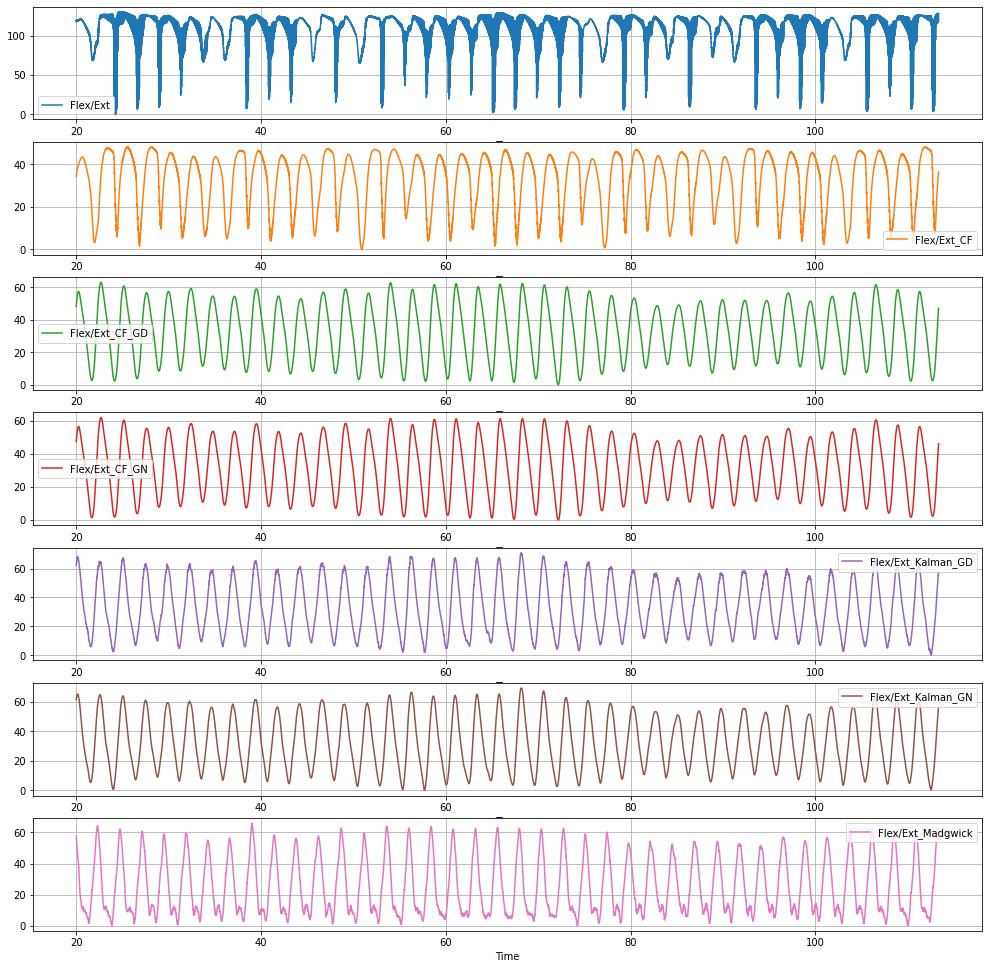

In [ ]:
#@title Knee angle plots from IMU
def df_plot(df,x_axis,y_axis,color=None,graph_type='line',subplots=False,grid=True,layout=None,size=(17,17)):
    plt.figure(figsize=size)
    ax = plt.gca()
    df.plot(kind=graph_type,x=x_axis,y=y_axis,ax=ax,color=color,layout=layout,subplots=subplots,grid=grid)
    plt.legend(loc='upper right')
    plt.show()

filters = ['Flex/Ext','Flex/Ext_CF','Flex/Ext_CF_GD','Flex/Ext_CF_GN',
           'Flex/Ext_Kalman_GD','Flex/Ext_Kalman_GN','Flex/Ext_Madgwick']
           
df_plot(knee_angle,'Time',filters,graph_type='line',subplots=True)

In [ ]:
#@title Knee angle from video
kinovea

,Time (ms),Knee Angle
0,0,"5,05740165710449"
1,33,"5,09946489334106"
2,67,"5,1323094367981"
3,100,"5,15325403213501"
4,133,"5,16673707962036"
...,...,...
5402,180028,"12,0119285583496"
5403,180062,"12,5518436431885"
5404,180095,"13,1136665344238"
5405,180128,"13,6940860748291"


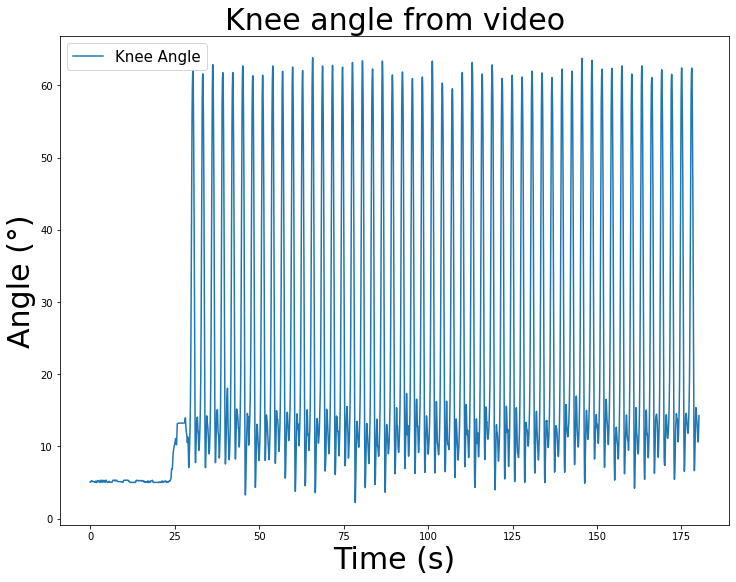

In [ ]:
#@title Knee angle from video
plt.figure(figsize=(12,9))
plt.plot(time_kinovea,data_kinovea)
plt.title('Knee angle from video',fontsize = 30);
plt.legend(['Knee Angle'], fontsize = 15)
plt.ylabel('Angle (°)',fontsize = 30);
plt.xlabel('Time (s)',fontsize = 30);

## Finding the gait cicle

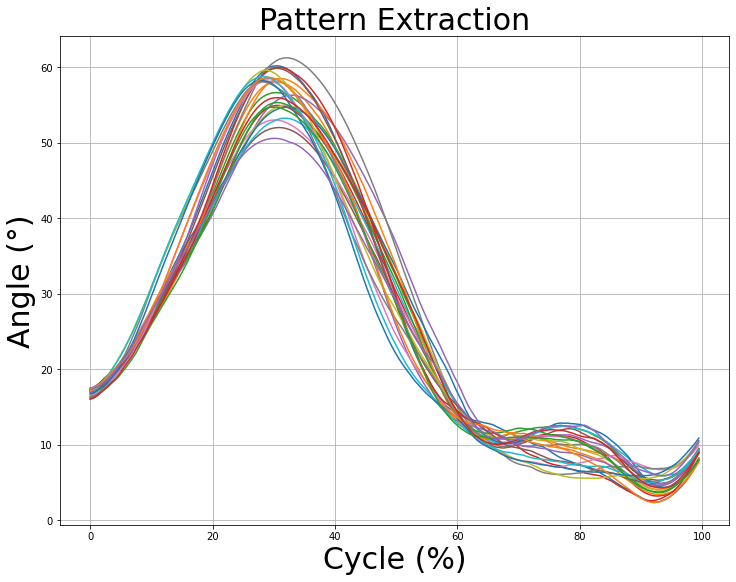

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)


In [ ]:
#Gait pattern from IMU
imu_cycle,_ = pjl.DataProcessing.pattern_extraction(knee_angle['Flex/Ext_Madgwick'],knee_angle['Time'],threshold=17.5,plot=True,bias=1);

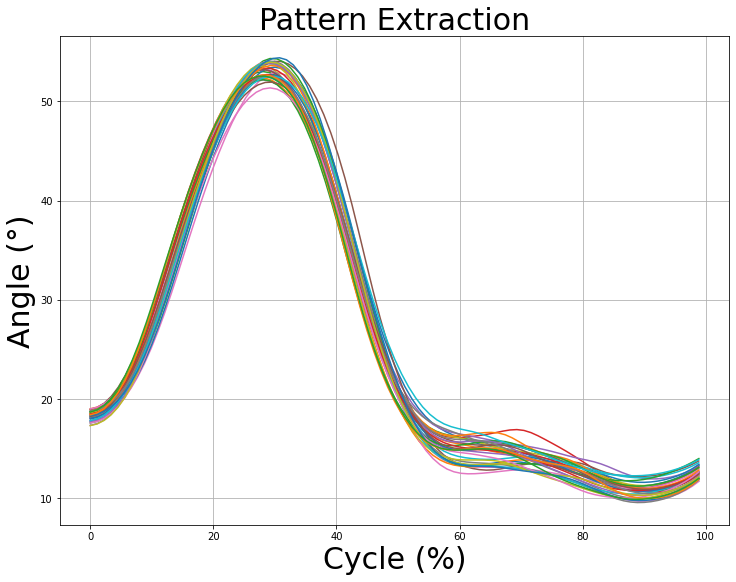

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)


In [ ]:
#Gai pattern from video
video_cycle,_ = pjl.DataProcessing.pattern_extraction(data_kinovea,time_kinovea,threshold=19,plot=True,df=False)

## Average cycles with 95% CI

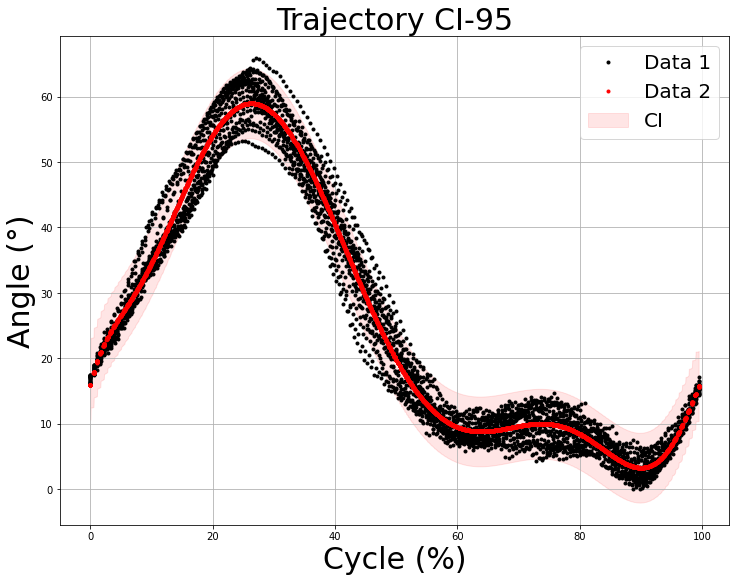

In [ ]:
#IMU average cycles
imu_pattern = pjl.DataProcessing.patternCI(imu_cycle[:,0],imu_cycle[:,1],plot=True,df=False, poly_degree=10)

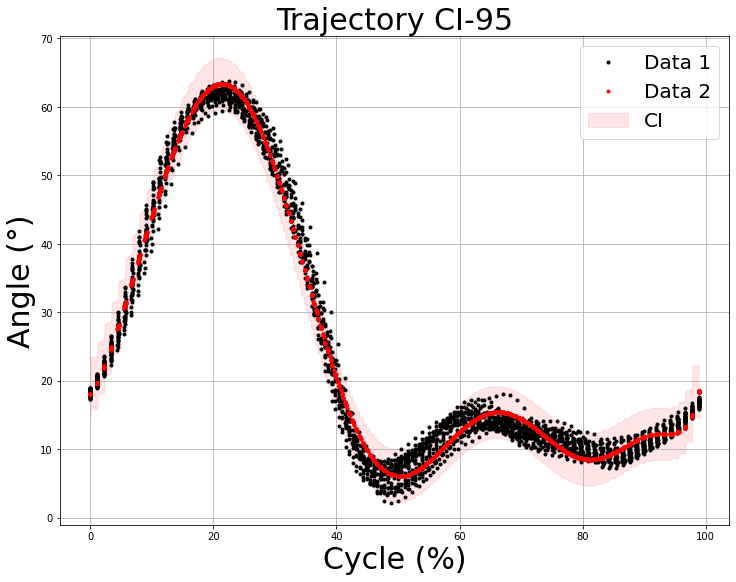

In [ ]:
#Video average cycles
video_pattern = pjl.DataProcessing.patternCI(video_cycle[:,0],video_cycle[:,1],plot=True,df=False, poly_degree=10)

## Data comparsion: IMU x Video

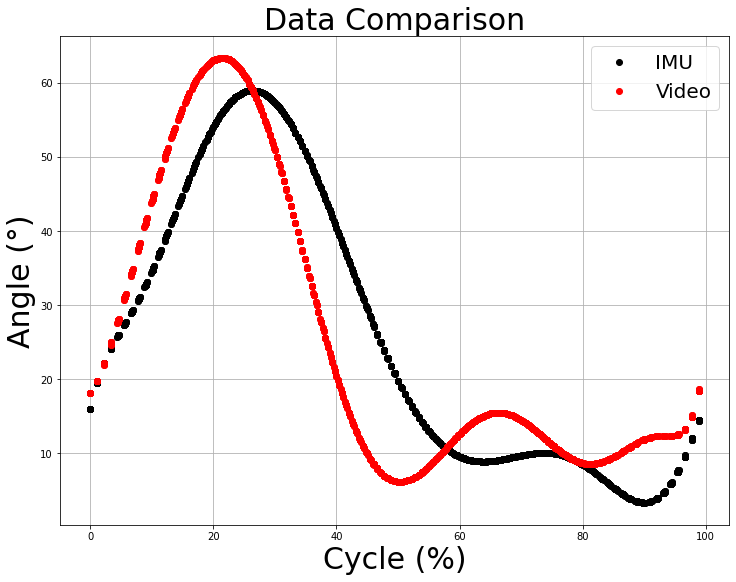

In [ ]:
imu_mean,video_mean = pjl.DataProcessing.data_comparison(video_cycle,imu_pattern,video_pattern,label1='IMU',label2='Video')